# Clustering Model Selection

We run a handful of clustering algorithms and hyperparameter combinations and try to make sense of the quality of results.

In [1]:
import os
import numpy as np
import pandas as pd
import geopandas as gpd
import seaborn as sns

In [6]:
data = pd.read_csv('../data/features/merged.csv')
# Read in data

## Create training data
### ... by filtering rows

In [7]:
# the row filter subsets the index too. we reset it here to make it easier to concatenate the training labels later on
training_data = data.loc[data['YEAR'] == 2016].reset_index(drop=True)

### ... by filtering columns

In [9]:
training_data = training_data.drop(['BEAT','YEAR','COMPLAINTS_COMPLAINANT_RACE_BlackorAfricanAmerican','COMPLAINTS_COMPLAINANT_RACE_Hispanic,Latino,orSpanishOrigin',
'COMPLAINTS_COMPLAINANT_RACE_White',
'COMPLAINTS_COMPLAINANT_RACE_Other',
'CRIME_Total',
'ISR_TOTAL_COUNT',
'ISR_RACE_CODE_CD_API',
'ISR_RACE_CODE_CD_BLK',
'ISR_RACE_CODE_CD_I',
'ISR_RACE_CODE_CD_P',
'ISR_RACE_CODE_CD_U',
'ISR_RACE_CODE_CD_WBH',
'ISR_RACE_CODE_CD_WHI',
'ISR_RACE_CODE_CD_WHT',
'ISR_RACE_CODE_CD_WWH',
'ISR_CNT_HISPANIC',
'UOF_DISTRICT',
'UOF_HISPANIC',
'UOF_BLACK',
'UOF_WHITE',
'CENSUS_beat',
'CENSUS_district',
'CENSUS_sector',
'CENSUS_Total Pop',
'CENSUS_White',
'CENSUS_Black',
'CENSUS_Hispanic',
'CENSUS_Median Income'], axis=1)




## Preprocess / transform data

In [11]:
from sklearn.preprocessing import StandardScaler
# Normalize columns
# This puts all features at same importance. We may want type or shootings to be more important somehow.
scaler = StandardScaler()
data_scaled = pd.DataFrame(scaler.fit_transform(training_data), columns=training_data.columns)

In [12]:
from sklearn.decomposition import PCA
# Do PCA
pca = PCA()
pca.fit(data_scaled)
data_pc = pd.DataFrame(pca.transform(data_scaled))

## Do clustering

In [13]:
from sklearn.cluster import KMeans, AgglomerativeClustering, DBSCAN, SpectralClustering
from sklearn.mixture import GaussianMixture
from sklearn.model_selection import ParameterGrid
from util_clustering import grid_search_clustering

params_km = {'n_clusters':[2,3,4,5,7,9]}
km_result = grid_search_clustering(KMeans(), \
    ParameterGrid(params_km), data_scaled, 'inertia_')

params_hagg = {'n_clusters':[2,3,4,5,7,9], 'affinity':['euclidean','cosine'], 'linkage':['complete','average','single']}
hagg_result = grid_search_clustering(AgglomerativeClustering(), \
    ParameterGrid(params_hagg), data_scaled)

params_dbscan = {'eps':[.01,.1,.2,.5,.9], 'min_samples':[2, 5, 10, 100], 'metric':['euclidean','cosine']}
dbscan_result = grid_search_clustering(DBSCAN(), \
    ParameterGrid(params_dbscan), data_scaled)

params_gauss = {'n_components':[2,3,4,5,7,9], 'n_init':[1,10]}
gauss_result = grid_search_clustering(GaussianMixture(), \
    ParameterGrid(params_gauss), data_scaled, 'lower_bound_')

params_spectral = [{'affinity': ['rbf'], 'n_clusters':[2,3,4,5,7,9]}, \
                   {'affinity': ['nearest_neighbors'], 'n_clusters':[2,3,4,5,7,9], \
                       'n_neighbors':[2, 5, 10, 100]}]
# spectral_result = grid_search_clustering(SpectralClustering(), \
    # ParameterGrid(params_spectral), data_scaled)

param_results = pd.concat([km_result, hagg_result, dbscan_result, gauss_result]) #, \
     #spectral_result])

Training KMeans with: {'n_clusters': 2}
Training Time Elapsed: 0:00:00.020037
Training KMeans with: {'n_clusters': 3}
Training Time Elapsed: 0:00:00.023790
Training KMeans with: {'n_clusters': 4}
Training Time Elapsed: 0:00:00.031736
Training KMeans with: {'n_clusters': 5}
Training Time Elapsed: 0:00:00.040649
Training KMeans with: {'n_clusters': 7}
Training Time Elapsed: 0:00:00.053877
Training KMeans with: {'n_clusters': 9}
Training Time Elapsed: 0:00:00.049075
Grid search completed.
Training AgglomerativeClustering with: {'affinity': 'euclidean', 'linkage': 'complete', 'n_clusters': 2}
Training Time Elapsed: 0:00:00.003954
Training AgglomerativeClustering with: {'affinity': 'euclidean', 'linkage': 'complete', 'n_clusters': 3}
Training Time Elapsed: 0:00:00.003556
Training AgglomerativeClustering with: {'affinity': 'euclidean', 'linkage': 'complete', 'n_clusters': 4}
Training Time Elapsed: 0:00:00.003332
Training AgglomerativeClustering with: {'affinity': 'euclidean', 'linkage': 'com

### Apply cluster labels to training data


In [16]:
def assign_clusterings(param_results, training_data):
    """
        Take the best model according to different metrics and extract the labels it produced
        Apply label vectors to original data frame
    """
    best_labels_km = param_results.loc[param_results['Model']=='KMeans'] \
        .sort_values(by='Score', ascending=True) \
        .head(1)['Labels'].to_numpy()[0]
    best_labels_gauss = param_results.loc[param_results['Model']=='GaussianMixture'] \
        .sort_values(by='Score', ascending=False) \
        .head(1)['Labels'].to_numpy()[0]
    best_labels_dbscore = param_results.sort_values(by='Davies-Bouldin', ascending=True) \
        .head(1)['Labels'].to_numpy()[0]
    best_labels_vrscore = param_results.sort_values(by='Halinski-Harabasz', ascending=True) \
        .head(1)['Labels'].to_numpy()[0]
    best_labels_silscore = param_results.sort_values(by='Silhouette', ascending=False) \
        .head(1)['Labels'].to_numpy()[0]

    label_cols = ['KMeans', 'Gauss', 'Davies', 'VarRatio', 'Silo']
    clustered = pd.concat([training_data, \
                        pd.Series(best_labels_km, name='KMeans'), \
                        pd.Series(best_labels_gauss, name='Gauss'), \
                        pd.Series(best_labels_dbscore, name='Davies-Bouldin'), \
                        pd.Series(best_labels_vrscore, name='Halinski-Harabasz'), \
                        pd.Series(best_labels_silscore, name='Silhouette'), \
                        ], axis=1)
    return clustered

## Try to make sense of results
### ... by plotting colored projections of data

In [29]:
# param_results.loc[param_results['Model'] == 'AgglomerativeClustering'].sort_values('Halinski-Harabasz', ascending=True) # NLabels = 4
# param_results.loc[param_results['Model'] == 'AgglomerativeClustering'].sort_values('Davies-Bouldin', ascending=True) # NLabels = 7
# param_results.loc[param_results['Model'] == 'AgglomerativeClustering'].sort_values('Silhouette', ascending=False) # NLabels = 2

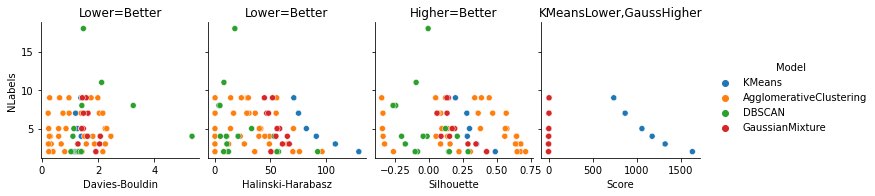

In [15]:
g = sns.pairplot(data=param_results, y_vars="NLabels",x_vars=["Davies-Bouldin","Halinski-Harabasz","Silhouette","Score"],hue="Model")
metric_titles = ['Lower=Better','Lower=Better','Higher=Better','KMeansLower,GaussHigher']
for ax, title in zip(g.axes.flat, metric_titles):
    ax.set(title=title)

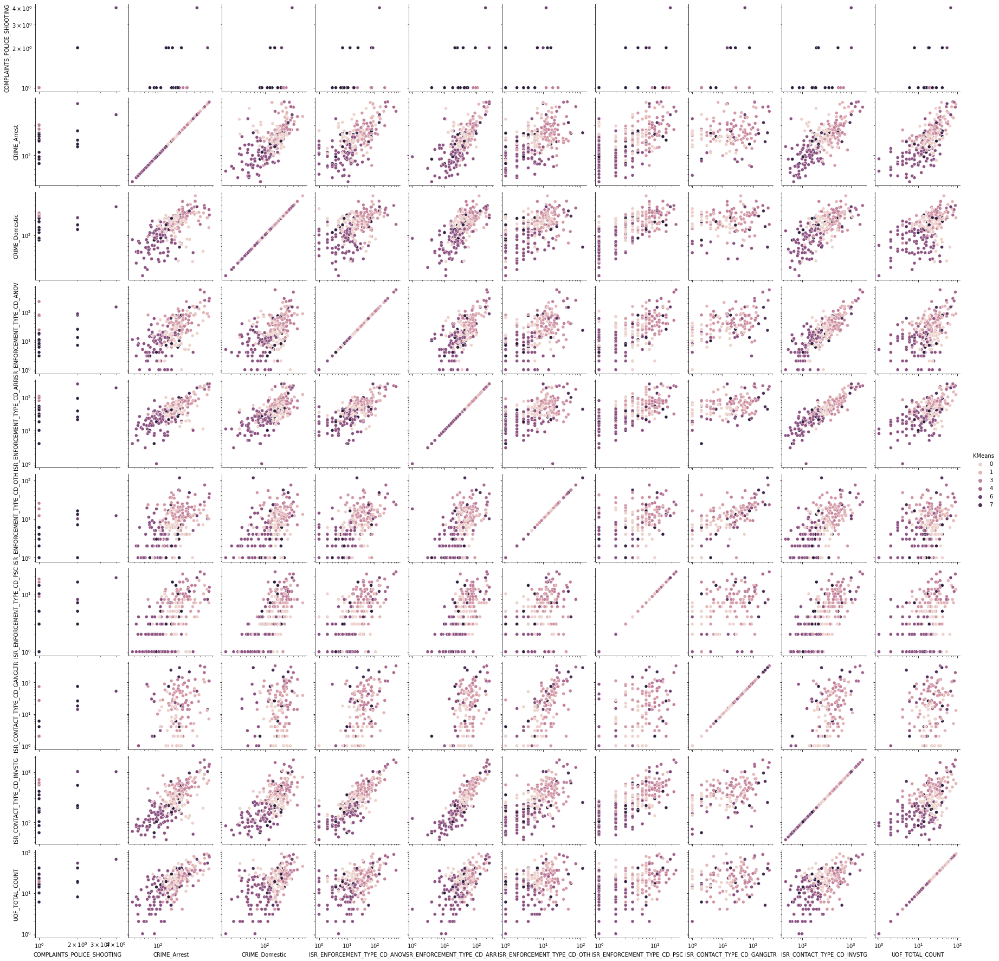

In [17]:
# Plot 2D projections of data, colored by cluster
clustered = assign_clusterings(param_results, training_data)
g=sns.pairplot(clustered, x_vars=training_data.columns, y_vars=training_data.columns, hue='KMeans', diag_kind=None)
g.set(xscale="log", yscale="log")

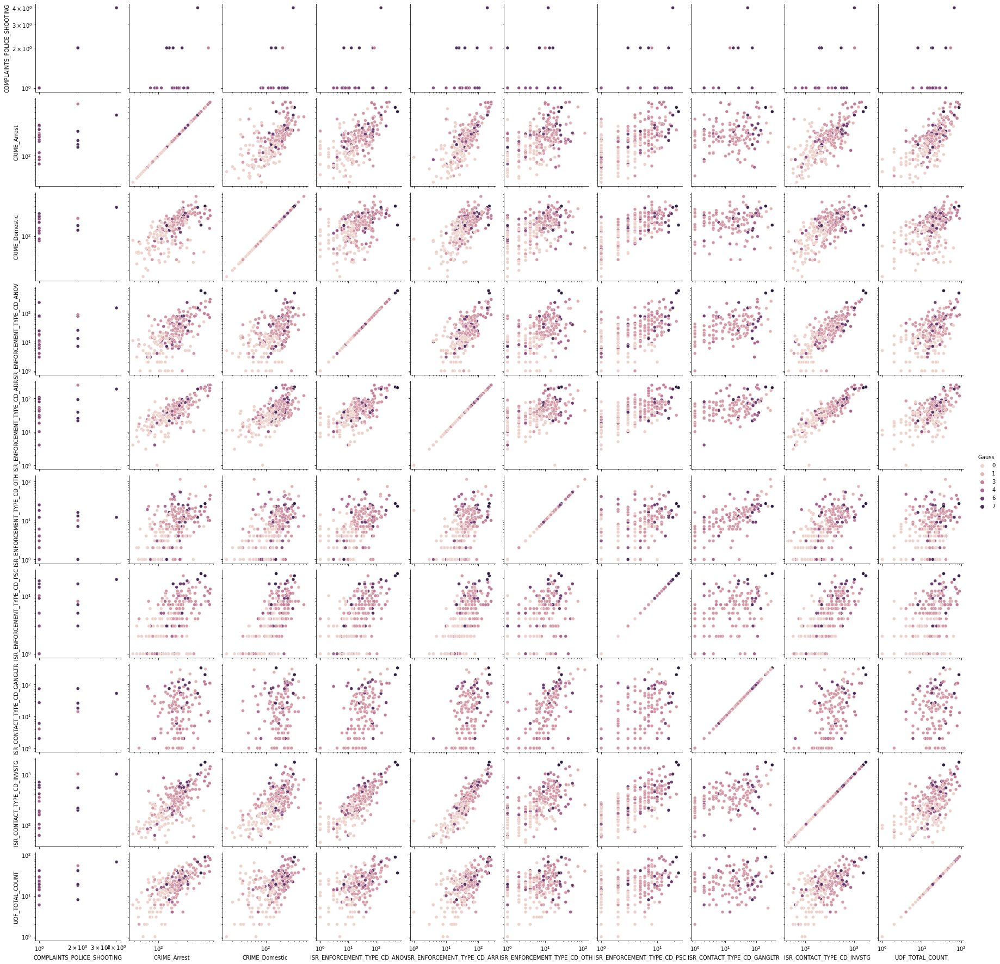

In [21]:
# Plot 2D projections of data, colored by cluster
g=sns.pairplot(clustered, x_vars=training_data.columns, y_vars=training_data.columns, hue='Gauss', diag_kind=None)
g.set(xscale="log", yscale="log")

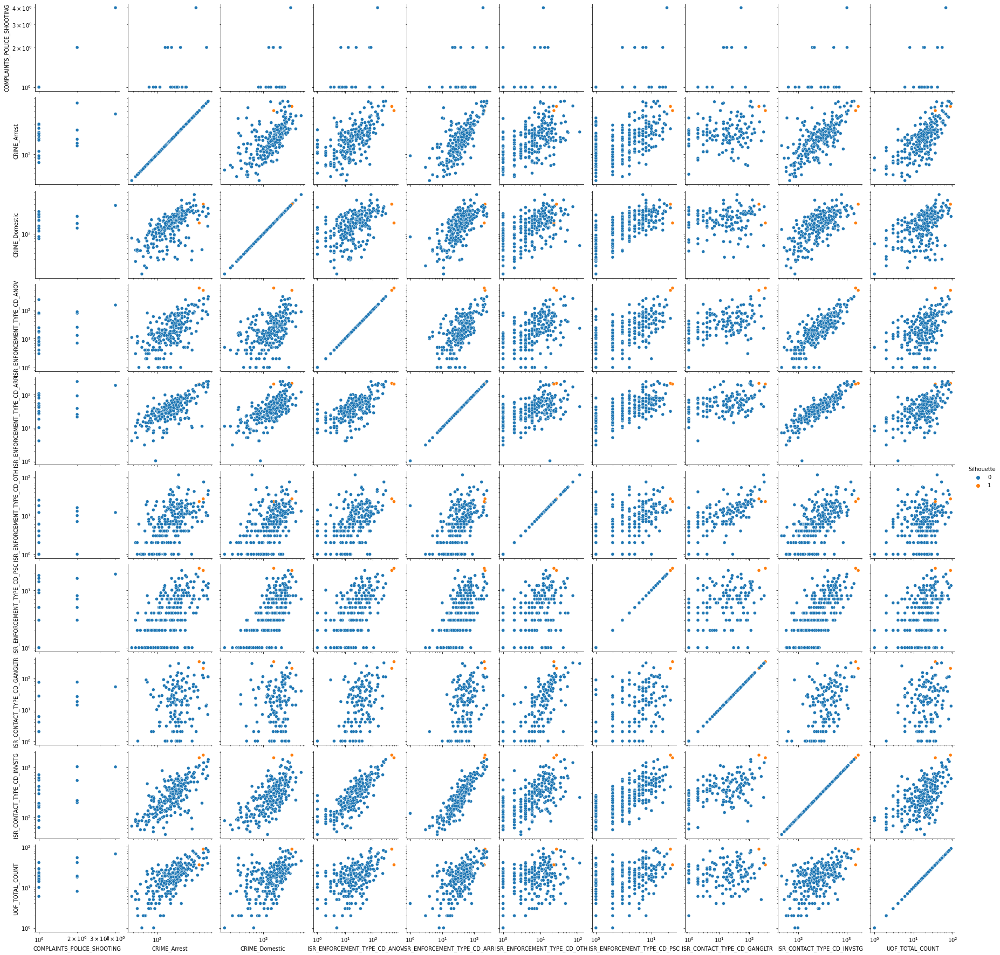

In [22]:
# Plot 2D projections of data, colored by cluster
g=sns.pairplot(clustered, x_vars=training_data.columns, y_vars=training_data.columns, hue='Silhouette', diag_kind=None)
g.set(xscale="log", yscale="log")

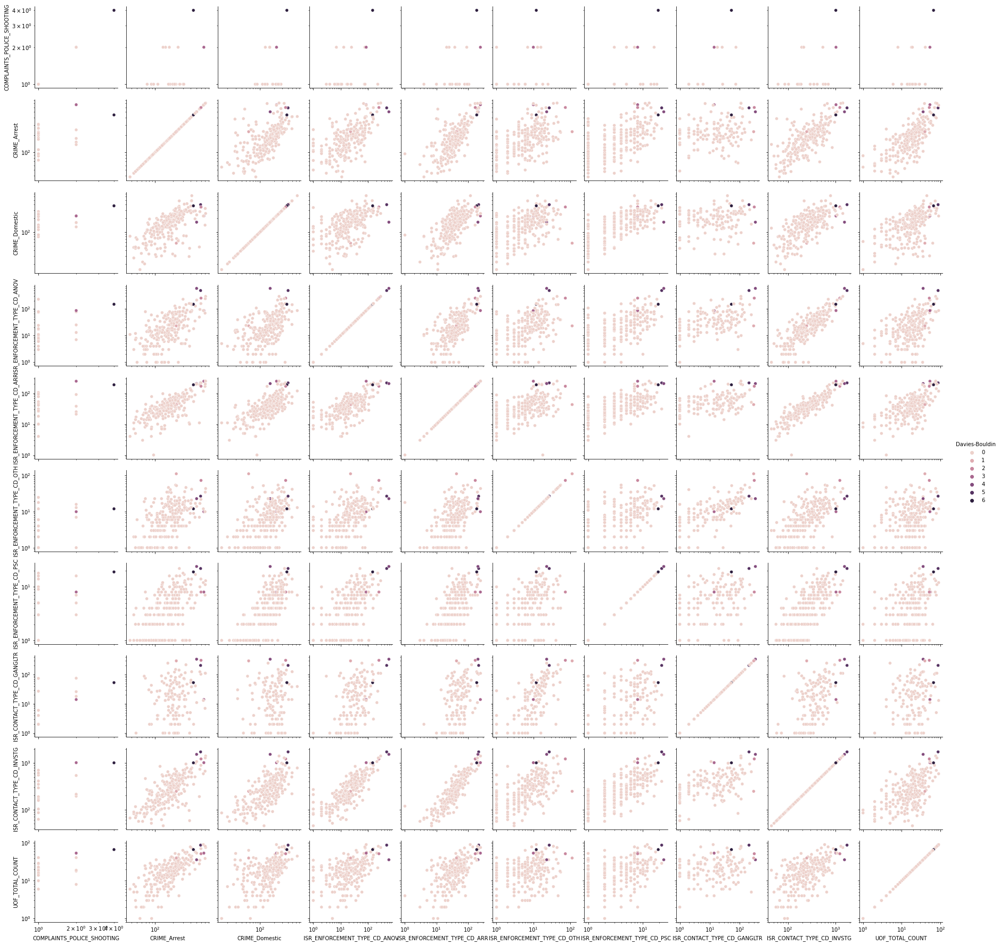

In [30]:
# Plot 2D projections of data, colored by cluster
g=sns.pairplot(clustered, x_vars=training_data.columns, y_vars=training_data.columns, hue='Davies-Bouldin', diag_kind=None)
g.set(xscale="log", yscale="log")

<AxesSubplot:>

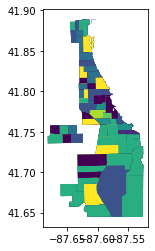

In [32]:
# Plot clusters geographically
beat_geos = gpd.read_file('../data/geographies/Boundaries - Police Beats (current).geojson')
beat_geos = beat_geos.assign(BEAT = pd.to_numeric(beat_geos['beat_num'], errors='coerce'))
beat_clusters = beat_geos.merge(clustered.assign(BEAT=data.BEAT), how='inner', on=['BEAT'])
beat_clusters.plot('KMeans')


### ... by learning supervised models on clustering to get feature importance

<AxesSubplot:>

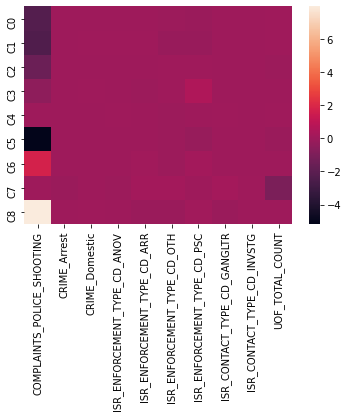

In [33]:
from sklearn.linear_model import LogisticRegression

lm = LogisticRegression(penalty='l1', solver='liblinear')
lm.fit(training_data, clustered['KMeans'])
n_classes = lm.coef_.shape[0]
n_features = lm.coef_.shape[1]
sns.heatmap(lm.coef_, yticklabels = [f"C{i}" for i in range(n_classes)], xticklabels=training_data.columns)

<AxesSubplot:>

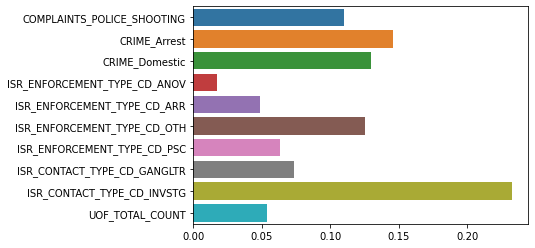

In [34]:
from sklearn.tree import DecisionTreeClassifier

tree = DecisionTreeClassifier()
tree.fit(training_data, clustered['KMeans'])
sns.barplot(y=training_data.columns, x=tree.feature_importances_)

### ... by searching all cluster sizes and watching feature importance

In [39]:
max_clusters = min(len(data['BEAT'].unique()), training_data.shape[0])
params_km_sweep = {'n_clusters':np.arange(1,max_clusters)}
km_sweep_result = grid_search_clustering(KMeans(), ParameterGrid(params_km_sweep), data_scaled, 'inertia_')

Training KMeans with: {'n_clusters': 1}
Training Time Elapsed: 0:00:00.054788
Training KMeans with: {'n_clusters': 2}
Training Time Elapsed: 0:00:00.018235
Training KMeans with: {'n_clusters': 3}
Training Time Elapsed: 0:00:00.031966
Training KMeans with: {'n_clusters': 4}
Training Time Elapsed: 0:00:00.053162
Training KMeans with: {'n_clusters': 5}
Training Time Elapsed: 0:00:00.039324
Training KMeans with: {'n_clusters': 6}
Training Time Elapsed: 0:00:00.038546
Training KMeans with: {'n_clusters': 7}
Training Time Elapsed: 0:00:00.045595
Training KMeans with: {'n_clusters': 8}
Training Time Elapsed: 0:00:00.054308
Training KMeans with: {'n_clusters': 9}
Training Time Elapsed: 0:00:00.054095
Training KMeans with: {'n_clusters': 10}
Training Time Elapsed: 0:00:00.055051
Training KMeans with: {'n_clusters': 11}
Training Time Elapsed: 0:00:00.065080
Training KMeans with: {'n_clusters': 12}
Training Time Elapsed: 0:00:00.067597
Training KMeans with: {'n_clusters': 13}
Training Time Elapse

<AxesSubplot:xlabel='n_clusters', ylabel='Score'>

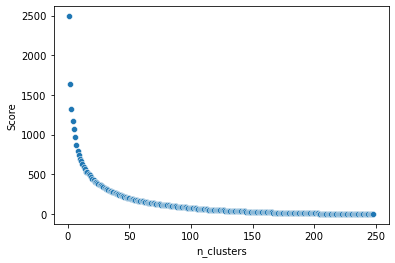

In [40]:
km_sweep_result_tbl = pd.concat([km_sweep_result, pd.json_normalize(km_sweep_result['Params'])],axis=1)
sns.scatterplot(data=km_sweep_result_tbl, x='n_clusters', y='Score')

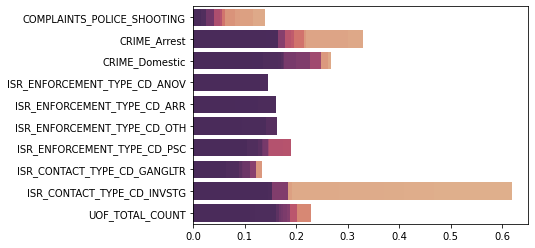

In [36]:
from sklearn.metrics import accuracy_score

sweep_labels = {}
for row in km_sweep_result.itertuples():
    sweep_labels[row.NLabels] = row.Labels

sweep_importances = {}
sweep_accuracy = {}
colors = sns.color_palette(palette='flare',n_colors=max_clusters)
for nlabels in sweep_labels.keys():
    tree.fit(training_data, sweep_labels[nlabels])
    sweep_importances[nlabels] = pd.Series(tree.feature_importances_, name=str(nlabels))
    sweep_accuracy[nlabels] = accuracy_score(sweep_labels[nlabels], tree.predict(training_data))
    # g = sns.barplot(y=training_data.columns, x=tree.feature_importances_, color=colors[nlabels])




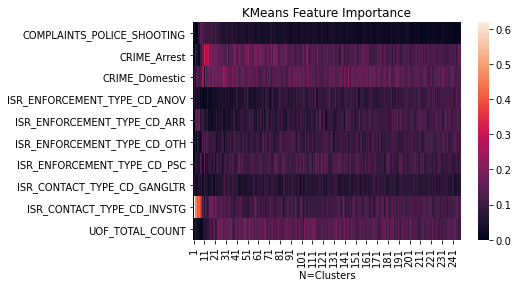

In [37]:
sweep_importance_df = pd.DataFrame(sweep_importances)
sweep_importance_df_melted = sweep_importance_df \
    .assign(FEATURE = lambda x: training_data.columns[x.index]) \
    .melt(id_vars='FEATURE', var_name='nclusters', value_name="importance")
sns.heatmap(sweep_importance_df, yticklabels=training_data.columns).set(xlabel='N=Clusters', title='KMeans Feature Importance');

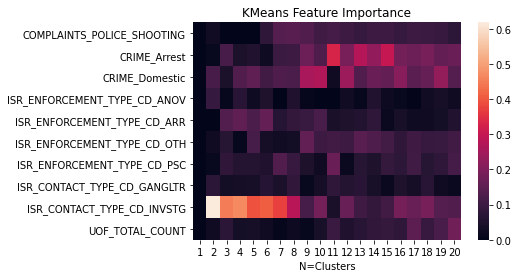

In [38]:
sns.heatmap(sweep_importance_df.loc[:,0:20], yticklabels=training_data.columns).set(xlabel='N=Clusters', title='KMeans Feature Importance');